<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist">
    
<h1 style="padding: 8px;color:white; display:fill;background-color:#555555; border-radius:5px; font-size:150%"><b> Table of contents </b></h1>

 - [**Introduction**](#1)

 - [**Explore**](#2)
 
 - [**Pre-processing and feature selection**](#3)
    
 - [**Modelling and Evaluation**](#4)
    - [**kNN**](#4_1)
    - [**Decision Tree**](#4_3)
    - [**Random Forest**](#4_5)
    - [**Gradient Boosting Classifier**](#4_6)
    - [**Neural Network MLP**](#4_7)
    
 - [**Evaluate**](#5)
 - [**Conclusion**](#6)
   

<a id='1'></a>
# <p style="padding: 8px;color:white; display:fill;background-color:#555555; border-radius:5px; font-size:100%"> <b>Introduction</b>

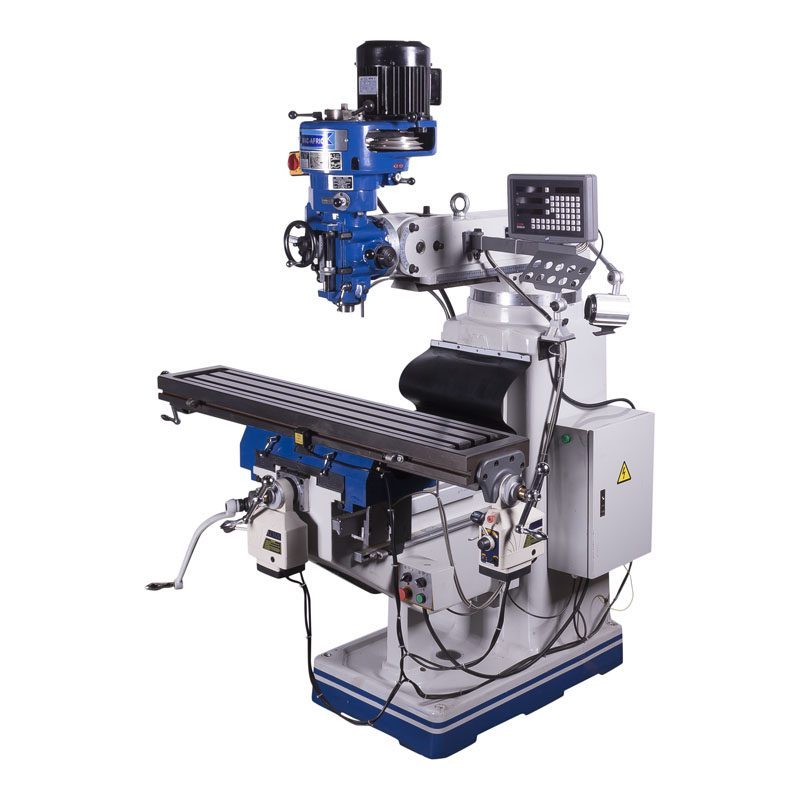

This synthetic dataset is modeled after an existing milling machine and consists of 10 000 data points from a stored as rows with 14 features in columns

1. UID: unique identifier ranging from 1 to 10000
2. product ID: consisting of a letter L, M, or H for low (50% of all products), medium (30%) and high (20%) as product quality variants and a variant-specific serial number
3. type: just the product type L, M or H from column 2
4. air temperature [K]: generated using a random walk process later normalized to a standard deviation of 2 K around 300 K
5. process temperature [K]: generated using a random walk process normalized to a standard deviation of 1 K, added to the air temperature plus 10 K.
6. rotational speed [rpm]: calculated from a power of 2860 W, overlaid with a normally distributed noise
7. torque [Nm]: torque values are normally distributed around 40 Nm with a SD = 10 Nm and no negative values.
8. tool wear [min]: The quality variants H/M/L add 5/3/2 minutes of tool wear to the used tool in the process.
9. a 'machine failure' label that indicates, whether the machine has failed in this particular datapoint for any of the following failure modes are true.

The machine failure consists of five independent failure modes

1. tool wear failure (TWF): the tool will be replaced of fail at a randomly selected tool wear time between 200 - 240 mins (120 times in our dataset). At this point in time, the tool is replaced 69 times, and fails 51 times (randomly assigned).
2. heat dissipation failure (HDF): heat dissipation causes a process failure, if the difference between air- and process temperature is below 8.6 K and the tools rotational speed is below 1380 rpm. This is the case for 115 data points.
3. power failure (PWF): the product of torque and rotational speed (in rad/s) equals the power required for the process. If this power is below 3500 W or above 9000 W, the process fails, which is the case 95 times in our dataset.
4. overstrain failure (OSF): if the product of tool wear and torque exceeds 11,000 minNm for the L product variant (12,000 M, 13,000 H), the process fails due to overstrain. This is true for 98 datapoints.
5. random failures (RNF): each process has a chance of 0,1 % to fail regardless of its process parameters. This is the case for only 5 datapoints, less than could be expected for 10,000 datapoints in our dataset.

If at least one of the above failure modes is true, the process fails and the 'machine failure' label is set to 1. It is therefore not transparent to the machine learning method, which of the failure modes has caused the process to fail.
This dataset is part of the following publication, please cite when using this dataset:
S. Matzka, "Explainable Artificial Intelligence for Predictive Maintenance Applications," 2020 Third International Conference on Artificial Intelligence for Industries (AI4I), 2020, pp. 69-74, doi: 10.1109/AI4I49448.2020.00023.

The image of the milling process is the work of Daniel Smyth @ Pexels: https://www.pexels.com/de-de/foto/industrie-herstellung-maschine-werkzeug-10406128/

<a id='2'></a>
# <p style="padding: 8px;color:white; display:fill;background-color:#555555; border-radius:5px; font-size:100%"> <b>Explore</b>

In [1]:
import numpy as np
import pandas as pd

from IPython.core.display import display, HTML
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.io as pio


import seaborn as sns
from importlib import reload
import matplotlib.pyplot as plt
import matplotlib
import warnings

# Configure Jupyter Notebook
pd.set_option('display.max_columns', None) 
pd.set_option('display.max_rows', 500) 
pd.set_option('display.expand_frame_repr', False)
# pd.set_option('max_colwidth', -1)
display(HTML("<style>div.output_scroll { height: 35em; }</style>"))

reload(plt)
%matplotlib inline
%config InlineBackend.figure_format ='retina'

warnings.filterwarnings('ignore')

# configure plotly graph objects
pio.renderers.default = 'iframe'
# pio.renderers.default = 'vscode'

pio.templates["ck_template"] = go.layout.Template(
    layout_colorway = px.colors.sequential.Viridis, 
#     layout_hovermode = 'closest',
#     layout_hoverdistance = -1,
    layout_autosize=False,
    layout_width=800,
    layout_height=600,
    layout_font = dict(family="Calibri Light"),
    layout_title_font = dict(family="Calibri"),
    layout_hoverlabel_font = dict(family="Calibri Light"),
#     plot_bgcolor="white",
)
 
# pio.templates.default = 'seaborn+ck_template+gridon'
pio.templates.default = 'ck_template+gridon'
# pio.templates.default = 'seaborn+gridon'
# pio.templates

In [2]:
df = pd.read_csv('/kaggle/input/predictive-maintenance-dataset-ai4i-2020/ai4i2020.csv')
# df = pd.read_csv('ai4i2020.csv')

First up is just to eyeball the data. It seems that there are two indices: the index and ProductID. We can drop those. There is a Type which is categorical and the remainder are numeric. The last five feastures are all failure modes, so they will not be evaluated in this notebook. 

In [3]:
df.head()

,UDI,Product ID,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,298.1,308.6,1551,42.8,0,0,0,0,0,0,0
1,2,L47181,L,298.2,308.7,1408,46.3,3,0,0,0,0,0,0
2,3,L47182,L,298.1,308.5,1498,49.4,5,0,0,0,0,0,0
3,4,L47183,L,298.2,308.6,1433,39.5,7,0,0,0,0,0,0
4,5,L47184,L,298.2,308.7,1408,40.0,9,0,0,0,0,0,0


There are no apparent missing values, but we'll check these out carefully to make sure

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   UDI                      10000 non-null  int64  
 1   Product ID               10000 non-null  object 
 2   Type                     10000 non-null  object 
 3   Air temperature [K]      10000 non-null  float64
 4   Process temperature [K]  10000 non-null  float64
 5   Rotational speed [rpm]   10000 non-null  int64  
 6   Torque [Nm]              10000 non-null  float64
 7   Tool wear [min]          10000 non-null  int64  
 8   Machine failure          10000 non-null  int64  
 9   TWF                      10000 non-null  int64  
 10  HDF                      10000 non-null  int64  
 11  PWF                      10000 non-null  int64  
 12  OSF                      10000 non-null  int64  
 13  RNF                      10000 non-null  int64  
dtypes: float64(3), int64(9)

In [5]:
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
UDI,10000.0,NaN,NaN,NaN,5000.5,2886.89568,1.0,2500.75,5000.5,7500.25,10000.0
Product ID,10000,10000,M14860,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Type,10000,3,L,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Air temperature [K],10000.0,NaN,NaN,NaN,300.00493,2.000259,295.3,298.3,300.1,301.5,304.5
Process temperature [K],10000.0,NaN,NaN,NaN,310.00556,1.483734,305.7,308.8,310.1,311.1,313.8
Rotational speed [rpm],10000.0,NaN,NaN,NaN,1538.7761,179.284096,1168.0,1423.0,1503.0,1612.0,2886.0
Torque [Nm],10000.0,NaN,NaN,NaN,39.98691,9.968934,3.8,33.2,40.1,46.8,76.6
Tool wear [min],10000.0,NaN,NaN,NaN,107.951,63.654147,0.0,53.0,108.0,162.0,253.0
Machine failure,10000.0,NaN,NaN,NaN,0.0339,0.180981,0.0,0.0,0.0,0.0,1.0
TWF,10000.0,NaN,NaN,NaN,0.0046,0.067671,0.0,0.0,0.0,0.0,1.0


making sure that there are no missing values hidden as a question mark

In [6]:
df.replace("?",np.nan,inplace=True)

turn all columns into float to make processing later easier

In [7]:
for column in df.columns:
    try:
        df[column]=df[column].astype(float)
    except:
        pass

just check the descriptions for the numeric features. None missing and on apparent outliers

In [8]:
# show the numeric characters
df_numeric = df.select_dtypes(include=[np.number])
df_numeric.describe(include='all').T

,count,mean,std,min,25%,50%,75%,max
UDI,10000.0,5000.50000,2886.895680,1.0,2500.75,5000.5,7500.25,10000.0
Air temperature [K],10000.0,300.00493,2.000259,295.3,298.30,300.1,301.50,304.5
Process temperature [K],10000.0,310.00556,1.483734,305.7,308.80,310.1,311.10,313.8
Rotational speed [rpm],10000.0,1538.77610,179.284096,1168.0,1423.00,1503.0,1612.00,2886.0
Torque [Nm],10000.0,39.98691,9.968934,3.8,33.20,40.1,46.80,76.6
Tool wear [min],10000.0,107.95100,63.654147,0.0,53.00,108.0,162.00,253.0
Machine failure,10000.0,0.03390,0.180981,0.0,0.00,0.0,0.00,1.0
TWF,10000.0,0.00460,0.067671,0.0,0.00,0.0,0.00,1.0
HDF,10000.0,0.01150,0.106625,0.0,0.00,0.0,0.00,1.0
PWF,10000.0,0.00950,0.097009,0.0,0.00,0.0,0.00,1.0


Another verification whether there are any missing features. I see none. 

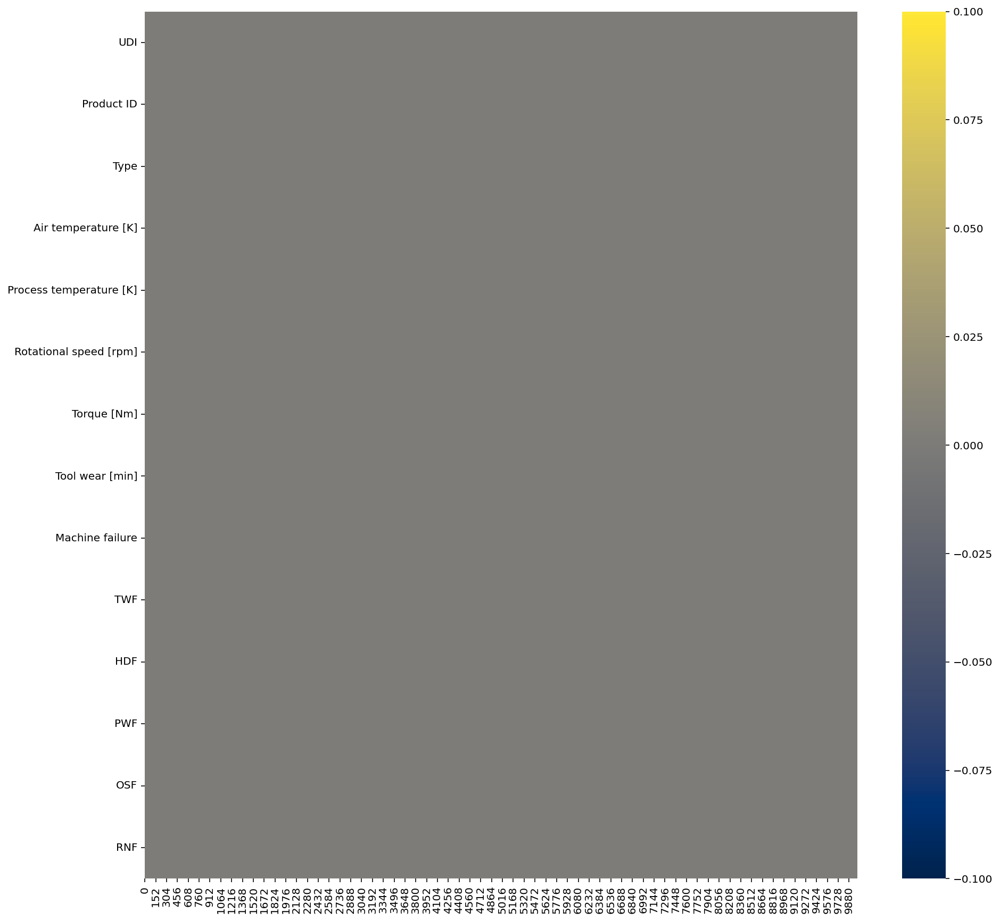

In [9]:
plt.figure(figsize=(15,15))
plot_kws={"s": 1}
sns.heatmap(df.isna().transpose(),
            cmap='cividis',
            linewidths=0.0,
           ).set_facecolor('white')

There are strongly correlated features namely process and air temperature. Torque and rotational speed are also strongly correlated. We can drop one of the temperatures, but the torque to rotational speed difference might be a indication of a failure, so we'll keep both.  

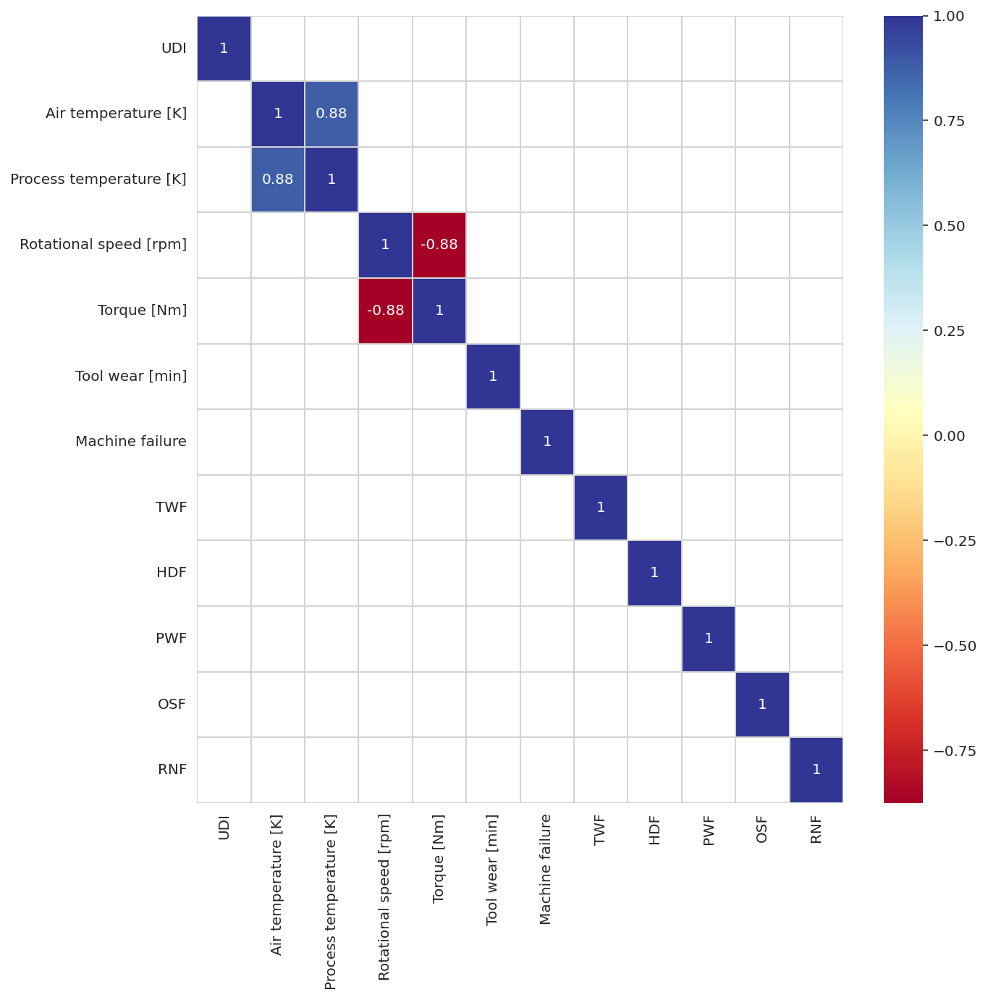

In [10]:
plt.figure(figsize=(10,10))
threshold = 0.80
sns.set_style("whitegrid", {"axes.facecolor": ".0"})
df_cluster2 = df.corr()
mask = df_cluster2.where((abs(df_cluster2) >= threshold)).isna()
plot_kws={"s": 1}
sns.heatmap(df_cluster2,
            cmap='RdYlBu',
            annot=True,
            mask=mask,
            linewidths=0.2, 
            linecolor='lightgrey').set_facecolor('white')

In [11]:
from pandas_profiling import ProfileReport

The profiling report follows to look for outliers, missing values, and distributions. We can see that the data is imbalanced. 

In [12]:
%%time
profile = ProfileReport(df,
                        title="Predictive Maintenance",
                        dataset={"description": "This profiling report was generated for Carl Kirstein",
                                 "copyright_holder": "Carl Kirstein",
                                 "copyright_year": "2022",
                                },
                        explorative=True,
                       )
profile

CPU times: user 4.09 ms, sys: 16 µs, total: 4.11 ms
Wall time: 4.12 ms


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Drop the indices as these have no predictive power

In [13]:
df.drop(['UDI','Product ID'],axis=1,inplace=True)

We incorporate the failure modes into a single feature for multiclass classification. Then we drop the individual failure modes.

In [14]:
df['TWF'].value_counts()

0.0    9954
1.0      46
Name: TWF, dtype: int64

In [15]:
df['Machine failure']=0
df['Machine failure'][df['TWF']==1]=1
df['Machine failure'][df['HDF']==1]=2
df['Machine failure'][df['PWF']==1]=3
df['Machine failure'][df['OSF']==1]=4
df['Machine failure'][df['RNF']==1]=5
df.drop(['TWF','HDF','PWF','OSF','RNF'],axis=1,inplace=True)

Drop the type, as this dominates too strongly on type = L.

In [16]:
# df['Type'][df['Type']=='L']=0
# df['Type'][df['Type']=='M']=1
# df['Type'][df['Type']=='H']=2
# df.drop(['Type'],axis=1,inplace=True)

There are a couple of features we can derive from the data. 
 - 1. power (the product of rotational speed and torque)
 - 2. Power and Wear - I wanted to divide the two, but it came down to infinity at some points, therefore I simply tried the product
 - 3. Process Temperature per Power output

In [17]:
df['Power']=df['Rotational speed [rpm]']*df['Torque [Nm]']
df['Power wear']=df['Power']*df['Tool wear [min]']
df['Temperature difference'] = df['Process temperature [K]']-df['Air temperature [K]']
df['Temperature power'] = df['Temperature difference']/df['Power']
df = df[['Air temperature [K]',
         'Process temperature [K]',
         'Rotational speed [rpm]',
         'Torque [Nm]',
         'Tool wear [min]',
         'Power',
         'Power wear',
         'Temperature difference',
         'Temperature power',
         'Type',
         'Machine failure'
        ]]

The remaining features

In [18]:
list(df)

['Air temperature [K]',
 'Process temperature [K]',
 'Rotational speed [rpm]',
 'Torque [Nm]',
 'Tool wear [min]',
 'Power',
 'Power wear',
 'Temperature difference',
 'Temperature power',
 'Type',
 'Machine failure']

Now we can check the correlations as well as a SPLOM combined. We see interesting patterns emerge in the new features, which could suggest that the data is generated from a simulation.

CPU times: user 20 s, sys: 309 ms, total: 20.3 s
Wall time: 19.9 s


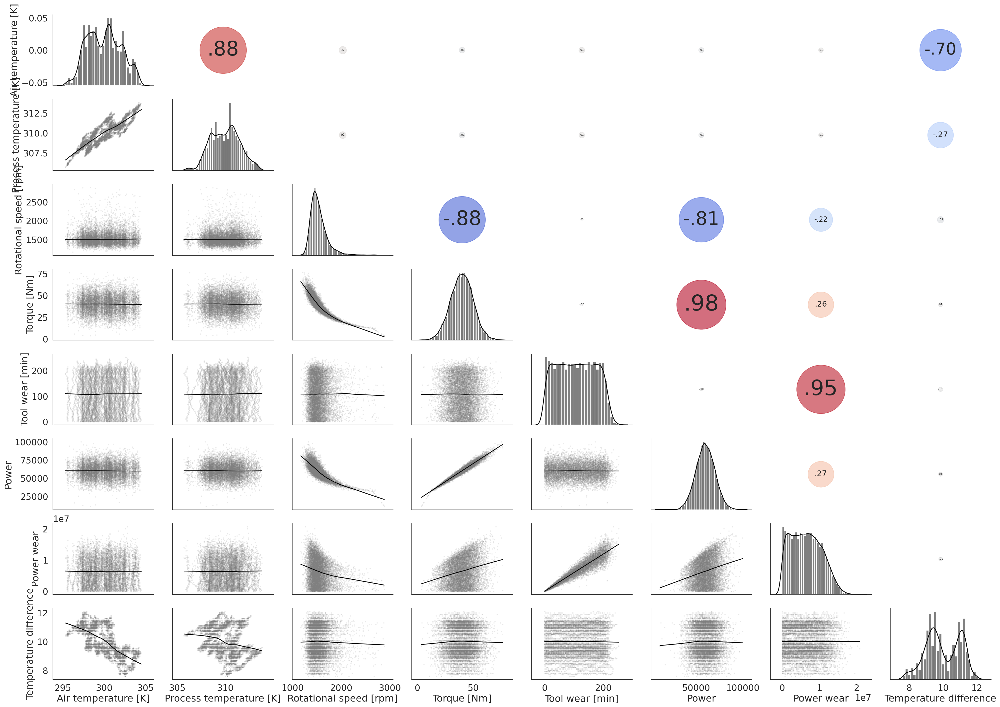

In [19]:
%%time

def corrdot(*args, **kwargs):
    corr_r = args[0].corr(args[1])
    corr_text = f"{corr_r:2.2f}".replace("0.", ".")
    ax = plt.gca()
    ax.set_axis_off()
    marker_size = abs(corr_r) * 10000
    ax.scatter([.5], [.5], marker_size, [corr_r], alpha=0.6, cmap='coolwarm',
               vmin=-1, vmax=1, transform=ax.transAxes)
    font_size = abs(corr_r) * 40 + 5
    ax.annotate(corr_text, [.5, .5,],  xycoords="axes fraction",
                ha='center', va='center', fontsize=font_size)

sns.set(style='white', font_scale=1.6)
g = sns.PairGrid(df.iloc[:,:8], aspect=1.4, diag_sharey=False)
g.map_lower(sns.regplot, lowess=True, ci=False, line_kws={'color': 'black','lw': 1.5}, scatter_kws={'s':3,'alpha':0.1,'color':'gray'})
g.map_diag(sns.distplot, kde_kws={'color': 'black'},hist_kws={'color':'gray','alpha':1,})
g.map_upper(corrdot)

turn categorical information into numeric 

In [20]:
df = pd.get_dummies(df,drop_first=True)

In [21]:
df.head()

,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Power,Power wear,Temperature difference,Temperature power,Machine failure,Type_L,Type_M
0,298.1,308.6,1551.0,42.8,0.0,66382.8,0.0,10.5,0.000158,0,0,1
1,298.2,308.7,1408.0,46.3,3.0,65190.4,195571.2,10.5,0.000161,0,1,0
2,298.1,308.5,1498.0,49.4,5.0,74001.2,370006.0,10.4,0.000141,0,1,0
3,298.2,308.6,1433.0,39.5,7.0,56603.5,396224.5,10.4,0.000184,0,1,0
4,298.2,308.7,1408.0,40.0,9.0,56320.0,506880.0,10.5,0.000186,0,1,0


In [22]:
df = df[['Air temperature [K]',
         'Process temperature [K]',
         'Rotational speed [rpm]',
         'Torque [Nm]',
         'Tool wear [min]',
         'Power',
         'Power wear',
         'Temperature difference',
         'Temperature power',
         'Type_L',
         'Type_M',
         'Machine failure'
        ]]

In [23]:
features = list(df.columns)

In [24]:
for feature in features:
    print(feature + " - " + str(len(df[df[feature].isna()])))

Air temperature [K] - 0
Process temperature [K] - 0
Rotational speed [rpm] - 0
Torque [Nm] - 0
Tool wear [min] - 0
Power - 0
Power wear - 0
Temperature difference - 0
Temperature power - 0
Type_L - 0
Type_M - 0
Machine failure - 0


Just another confirmation of how badly imbalanced the data is. We might need to oversample in this case to get a better prediction.

In [25]:
df_group = df.groupby(['Machine failure'])
df_group.count()

,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Power,Power wear,Temperature difference,Temperature power,Type_L,Type_M
Machine failure,,,,,,,,,,,
0,9652,9652,9652,9652,9652,9652,9652,9652,9652,9652,9652
1,42,42,42,42,42,42,42,42,42,42,42
2,106,106,106,106,106,106,106,106,106,106,106
3,83,83,83,83,83,83,83,83,83,83,83
4,98,98,98,98,98,98,98,98,98,98,98
5,19,19,19,19,19,19,19,19,19,19,19


In [26]:
df[df['Machine failure'].isna()]

,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Power,Power wear,Temperature difference,Temperature power,Type_L,Type_M,Machine failure


in the pairplot below we see some evidence of clustering. This matters, since it would make the kNN more desirable, especially if the clusters are far apart from each other. 

CPU times: user 1min 11s, sys: 793 ms, total: 1min 12s
Wall time: 1min 11s


<Figure size 720x720 with 0 Axes>

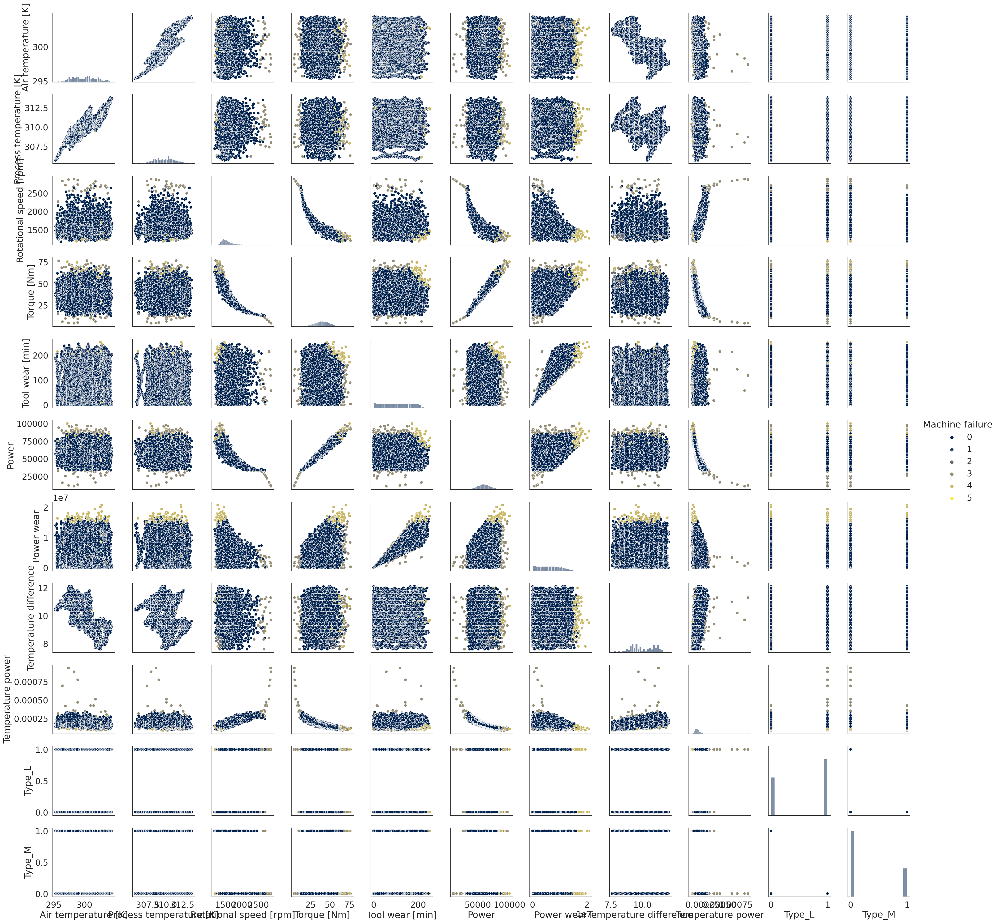

In [27]:
%%time
plt.figure(figsize=(10,10))
sns.set_style('white')
plot_kws={"s": 1}
g = sns.pairplot(
             df,
             # kind='reg',
             diag_kind='hist',
             corner=False,
             # plot_kws=dict(scatter_kws=dict(s=5)),
             palette='cividis',
             hue='Machine failure'
            )

# g = g.map_diag(sns.kdeplot, lw=2)
# g = g.map_offdiag(sns.kdeplot, lw=0.5)
plt.show()

In [28]:
%%time
from sklearn.impute import SimpleImputer
from sklearn.pipeline import make_pipeline
import umap
from sklearn.preprocessing import PowerTransformer

# Scale
pipe = make_pipeline(PowerTransformer())
X = df.iloc[:,:-1]
y = df.iloc[:,-1]
X = pipe.fit_transform(X.copy())

# Encode the target to numeric
y_encoded = pd.factorize(y)[0]

manifold = umap.UMAP(n_components=5).fit(X, y_encoded)

X_UMAP = manifold.transform(X)

CPU times: user 1min 29s, sys: 2.46 s, total: 1min 32s
Wall time: 57.8 s


The UMAP (which is kind of a principal component analysis) shows that there are indeed clusters and the small clusters (failure modes) are relatively far apart. We expect kNN to do well then, and even the Tree models.

CPU times: user 15.4 s, sys: 501 ms, total: 15.9 s
Wall time: 15.1 s


<Figure size 720x720 with 0 Axes>

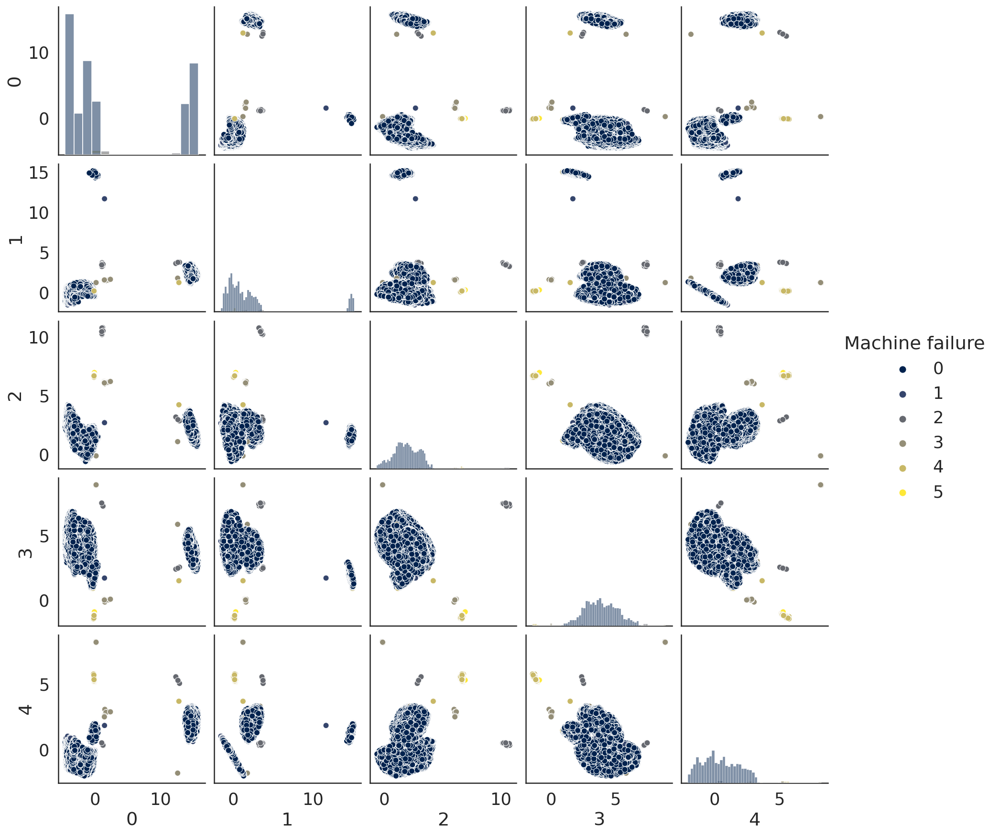

In [29]:
%%time
df_UMAP = pd.DataFrame(X_UMAP)
df_UMAP['Machine failure']=df['Machine failure']

plt.figure(figsize=(10,10))
sns.set_style('white')
plot_kws={"s": 1}
g = sns.pairplot(
             df_UMAP,
             # kind='reg',
             diag_kind='hist',
             corner=False,
             # plot_kws=dict(scatter_kws=dict(s=5)),
             palette='cividis',
             hue='Machine failure'
            )

# g = g.map_diag(sns.kdeplot, lw=2)
# g = g.map_offdiag(sns.kdeplot, lw=0.5)
plt.show()

In [30]:
from sklearn.decomposition import PCA

# Create principal components
pca = PCA()
# X_pca = pca.fit_transform(df[['Length','Diameter','Height','Whole weight','Shucked weight','Viscera weight','Shell weight']])
X_pca = pca.fit_transform(df)

# Convert to dataframe
component_names = [f"PC{i+1}" for i in range(X_pca.shape[1])]
X_pca = pd.DataFrame(X_pca, columns=component_names)
X_pca['Machine failure'] = df['Machine failure']
X_pca.head(10)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,Machine failure
0,-6.471436e+06,-10853.077800,102.587365,8.336356,2.412661,-1.889262,-0.211565,0.884103,0.279752,-0.112718,9.625773e-08,5.750746e-14,0
1,-6.275866e+06,-9528.701918,-57.314864,5.971640,2.185639,0.551922,-0.097208,-0.520281,-0.014446,-0.053505,-3.083217e-06,-6.054580e-15,0
2,-6.101425e+06,-18217.697871,157.501400,20.682654,2.467193,-1.823788,-0.346228,-0.526275,0.097954,-0.051349,3.573808e-06,9.121964e-16,0
3,-6.075218e+06,-804.708010,-153.900061,-8.355992,2.170830,0.648453,-0.236555,-0.516587,0.032736,-0.056447,5.691041e-07,1.068855e-15,0
4,-5.964563e+06,-445.701394,-182.910957,-8.666143,2.126651,1.017886,-0.087985,-0.517114,0.015697,-0.056571,6.225513e-07,1.073834e-15,0
5,-5.814658e+06,-3729.809836,-117.922403,-3.133857,2.295630,0.571721,-0.143811,0.889582,0.148075,-0.114448,-1.149940e-06,9.421197e-16,0
6,-5.546607e+06,-9895.146636,105.080008,6.764462,2.420878,-1.952592,-0.212153,-0.517316,0.127325,-0.054288,-1.385252e-07,9.270355e-16,0
7,-5.489273e+06,-5182.937363,7.885462,-0.399117,2.370548,-1.013477,-0.186827,-0.515029,0.092143,-0.055518,-9.961746e-07,9.435332e-16,0
8,-5.613277e+06,8441.820028,-46.274902,-20.383091,2.113262,-0.247278,-0.210131,0.912956,0.155291,-0.116913,5.538979e-06,1.057725e-15,0
9,-5.447740e+06,7484.707166,42.920965,-18.136807,1.866682,-0.664722,0.010298,0.920429,0.126693,-0.115907,8.476678e-07,9.965277e-16,0


Principal component number 8 shows once again that there are clusters that can be exploited, although these are not spherical... kNN will probably not do well, although the Trees might still do well.

<Figure size 1080x1080 with 0 Axes>

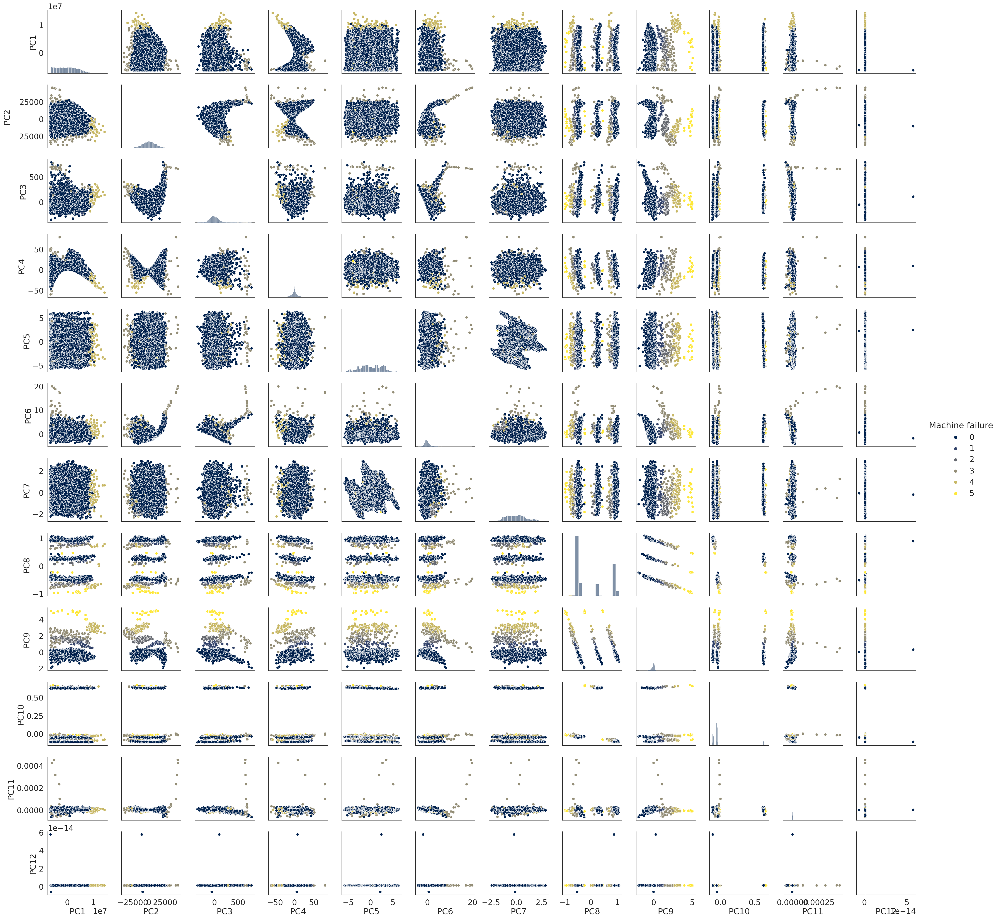

In [31]:
plt.figure(figsize=(15,15))
sns.set_style('white')
plot_kws={"s": 1}
g = sns.pairplot(
             X_pca,
             # kind='reg',
             diag_kind='hist',
             corner=False,
             # plot_kws=dict(scatter_kws=dict(s=5)),
             palette='cividis',
             hue='Machine failure'
            )

# g = g.map_diag(sns.kdeplot, lw=2)
# g = g.map_offdiag(sns.kdeplot, lw=0.5)
plt.show()

In [32]:
from random import sample
from numpy.random import uniform
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import scale, normalize

# function to compute hopkins's statistic for the dataframe X
def hopkins_statistic(X,k=2):
    try: 
        X=X.values  #convert dataframe to a numpy array
    except:
        pass
    # X = scale(X)
    X = normalize(X)
    sample_size = int(X.shape[0]*0.05) #0.05 (5%) based on paper by Lawson and Jures
    
    
    #a uniform random sample in the original data space
    X_uniform_random_sample = uniform(X.min(axis=0), X.max(axis=0) ,(sample_size , X.shape[1]))
    
    
    
    #a random sample of size sample_size from the original data X
    random_indices=sample(range(0, X.shape[0], 1), sample_size)
    X_sample = X[random_indices]
   
    
    #initialise unsupervised learner for implementing neighbor searches
    neigh = NearestNeighbors(n_neighbors=k)
    nbrs=neigh.fit(X)
    
    #u_distances = nearest neighbour distances from uniform random sample
    u_distances , u_indices = nbrs.kneighbors(X_uniform_random_sample , n_neighbors=k)
    u_distances = u_distances[: , 0] #distance to the first (nearest) neighbour
    
    #w_distances = nearest neighbour distances from a sample of points from original data X
    w_distances , w_indices = nbrs.kneighbors(X_sample , n_neighbors=k)
    #distance to the second nearest neighbour (as the first neighbour will be the point itself, with distance = 0)
    w_distances = w_distances[: , 1]
    
 
    
    u_sum = np.sum(u_distances)
    w_sum = np.sum(w_distances)
    
    #compute and return hopkins' statistic
    H = u_sum/ (u_sum + w_sum)
    return H

H=hopkins_statistic(X,3)
print('Hopkins statistic: '+str(H))

Hopkins statistic: 0.8484319136862343


The Hopkins statistic above confirms clusters. 

<a id='3'></a>
# <p style="padding: 8px;color:white; display:fill;background-color:#555555; border-radius:5px; font-size:100%"> <b>Pre-processing and Feature Selection</b>

replace the missing numeric values with the mean

In [33]:
df_numeric.fillna(df_numeric.mean(),inplace=True)

for feature in features:
    try:
        df[feature].fillna(df[feature].mean(),inplace=True)
    except:
        try:
            df[feature].fillna(df[feature].mode(),inplace=True)
        except:
            pass

In [34]:
df.describe(include='all').T

,count,mean,std,min,25%,50%,75%,max
Air temperature [K],10000.0,3.000049e+02,2.000259e+00,295.300000,2.983000e+02,3.001000e+02,3.015000e+02,3.045000e+02
Process temperature [K],10000.0,3.100056e+02,1.483734e+00,305.700000,3.088000e+02,3.101000e+02,3.111000e+02,3.138000e+02
Rotational speed [rpm],10000.0,1.538776e+03,1.792841e+02,1168.000000,1.423000e+03,1.503000e+03,1.612000e+03,2.886000e+03
Torque [Nm],10000.0,3.998691e+01,9.968934e+00,3.800000,3.320000e+01,4.010000e+01,4.680000e+01,7.660000e+01
Tool wear [min],10000.0,1.079510e+02,6.365415e+01,0.000000,5.300000e+01,1.080000e+02,1.620000e+02,2.530000e+02
Power,10000.0,5.996715e+04,1.019309e+04,10966.800000,5.310540e+04,5.988390e+04,6.687375e+04,9.998040e+04
Power wear,10000.0,6.471442e+06,4.016716e+06,0.000000,3.096389e+06,6.287880e+06,9.489756e+06,2.081921e+07
Temperature difference,10000.0,1.000063e+01,1.001094e+00,7.600000,9.300000e+00,9.800000e+00,1.100000e+01,1.210000e+01
Temperature power,10000.0,1.721398e-04,3.840703e-05,0.000086,1.463591e-04,1.669861e-04,1.921325e-04,9.361434e-04
Type_L,10000.0,6.000000e-01,4.899224e-01,0.000000,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00


Perform a statistical univariate test to determine the best features. Product type L dominates this strongly.

In [35]:
# Feature Selection
from sklearn.feature_selection import SelectKBest, chi2

best_features = SelectKBest(score_func=chi2,k='all')

X = df.iloc[:,:-1]
y = df.iloc[:,-1]
fit = best_features.fit(X,y)

df_scores=pd.DataFrame(fit.scores_)
df_col=pd.DataFrame(X.columns)

feature_score=pd.concat([df_col,df_scores],axis=1)
feature_score.columns=['feature','score']
feature_score.sort_values(by=['score'],ascending=True,inplace=True)

fig = go.Figure(go.Bar(
            x=feature_score['score'][0:21],
            y=feature_score['feature'][0:21],
            orientation='h'))

fig.update_layout(title="Top 20 Features",
                  height=1200,
                  showlegend=False,
                 )

fig.show()

In [36]:
# awesome bit of code from https://www.kaggle.com/code/adibouayjan/house-price-step-by-step-modeling

Selected_Features = []
import statsmodels.api as sm

def backward_regression(X, y, initial_list=[], threshold_out=0.05, verbose=True):
    """To select feature with Backward Stepwise Regression 

    Args:
        X -- features values
        y -- target variable
        initial_list -- features header
        threshold_out -- pvalue threshold of features to drop
        verbose -- true to produce lots of logging output

    Returns:
        list of selected features for modeling 
    """
    included = list(X.columns)
    while True:
        changed = False
        model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included]))).fit()
        # use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max()  # null if pvalues is empty
        if worst_pval > threshold_out:
            changed = True
            worst_feature = pvalues.idxmax()
            included.remove(worst_feature)
            if verbose:
                print(f"worst_feature : {worst_feature}, {worst_pval} ")
        if not changed:
            break
    Selected_Features.append(included)
    print(f"\nSelected Features:\n{Selected_Features[0]}")


# Application of the backward regression function on our training data
backward_regression(X, y)

worst_feature : Type_M, 0.8673814624251963 

Selected Features:
['Air temperature [K]', 'Process temperature [K]', 'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]', 'Power', 'Power wear', 'Temperature difference', 'Temperature power', 'Type_L']


In [37]:
X = df.iloc[:,:-1]
y = df.iloc[:,-1]

In [38]:
X.head()
feature_names = list(X.columns)
np.shape(X)

(10000, 11)

In [39]:
len(feature_names)

11

<a id='4'></a>
# <p style="padding: 8px;color:white; display:fill;background-color:#555555; border-radius:5px; font-size:100%"> <b>Modelling and Evaluation</b>

The data is too imbalanced, therefore we usually oversample. The randomoversampler performs better than SMOTE, but not oversampling performs the best. This is curious, but there are studies (check my discussion here: https://www.kaggle.com/competitions/autismdiagnosis/discussion/322588) that reckon that it is better not to oversample.

In [40]:
# import library
from imblearn.over_sampling import SMOTE, SVMSMOTE,RandomOverSampler
oversamp = RandomOverSampler(random_state=0)
# oversamp = SMOTE(n_jobs=-1)

In [41]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size = 0.2, 
                                                    random_state = 0,
                                                    stratify=y)
# X_train,y_train = oversamp.fit_resample(X_train, y_train)

There are no distinct outliers, therefore a simple minmax scaler suffices. 

In [42]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [43]:
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score,roc_auc_score, plot_confusion_matrix,matthews_corrcoef
from sklearn.metrics import plot_confusion_matrix # will plot the confusion matrix

import time
model_performance = pd.DataFrame(columns=['Accuracy','Recall','Precision','F1-Score','MCC score','time to train','time to predict','total time'])


<a id='4_1'></a>
## <p style="padding: 8px;color:white; display:fill;background-color:#aaaaaa; border-radius:5px; font-size:100%"> <b>kNN</b>

In [44]:
%%time
from sklearn.neighbors import KNeighborsClassifier
start = time.time()
model = KNeighborsClassifier(n_neighbors=3).fit(X_train,y_train)
end_train = time.time()
y_predictions = model.predict(X_test) # These are the predictions from the test data.
end_predict = time.time()

CPU times: user 122 ms, sys: 0 ns, total: 122 ms
Wall time: 124 ms


In [45]:
accuracy = accuracy_score(y_test, y_predictions)
recall = recall_score(y_test, y_predictions, average='weighted')
precision = precision_score(y_test, y_predictions, average='weighted')
f1s = f1_score(y_test, y_predictions, average='weighted')
MCC = matthews_corrcoef(y_test, y_predictions)
# ROC_AUC = roc_auc_score(y_test, y_predictions, average='weighted')
# ROC_AUC = roc_auc_score(y_test, model.predict_proba(X_test)[:,1], average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
print("MCC: "+ "{:.2%}".format(MCC))
# print("ROC AUC score: "+ "{:.2%}".format(ROC_AUC))
print("time to train: "+ "{:.2f}".format(end_train-start)+" s")
print("time to predict: "+"{:.2f}".format(end_predict-end_train)+" s")
print("total: "+"{:.2f}".format(end_predict-start)+" s")
model_performance.loc['Logistic'] = [accuracy, recall, precision, f1s,MCC,end_train-start,end_predict-end_train,end_predict-start]

Accuracy: 97.30%
Recall: 97.30%
Precision: 96.27%
F1-Score: 96.56%
MCC: 49.77%
time to train: 0.01 s
time to predict: 0.11 s
total: 0.12 s


The figure below shows the confusion matrix for the predictions, the numbers predicted are as follows:
0. No failure
1. tool wear failure (TWF)
2. heat dissipation failure (HDF)
3. power failure (PWF)
4. overstrain failure (OSF)
5. random failures (RNF)

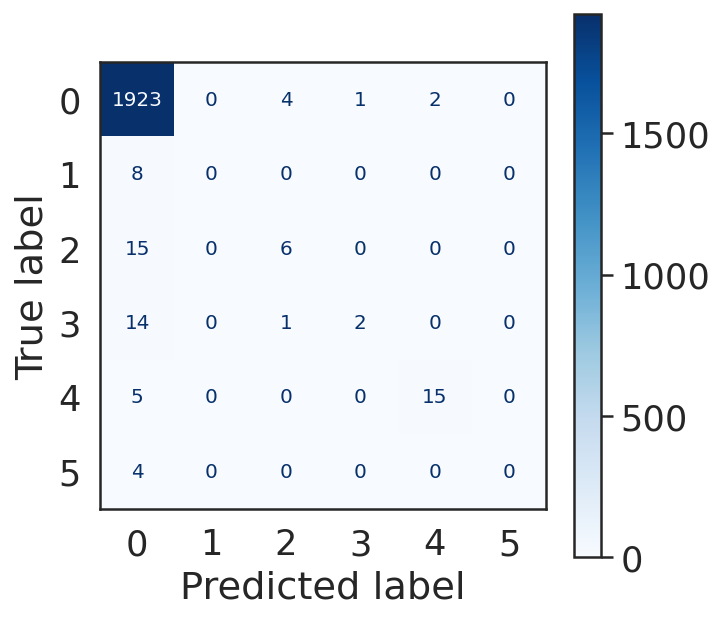

In [46]:
plt.rcParams['figure.figsize']=5,5 
plt.rcParams['font.size'] = 10
sns.set_style("white")
plot_confusion_matrix(model, X_test, y_test, cmap=plt.cm.Blues)  
plt.show()

<a id='4_3'></a>
## <p style="padding: 8px;color:white; display:fill;background-color:#aaaaaa; border-radius:5px; font-size:100%"> <b>Decision Tree</b>

In [47]:
%%time
from sklearn.tree import DecisionTreeClassifier
start = time.time()
model = DecisionTreeClassifier().fit(X_train,y_train)
end_train = time.time()
y_predictions = model.predict(X_test) # These are the predictions from the test data.
end_predict = time.time()

CPU times: user 91.9 ms, sys: 8 µs, total: 91.9 ms
Wall time: 94.3 ms


In [48]:
accuracy = accuracy_score(y_test, y_predictions)
recall = recall_score(y_test, y_predictions, average='weighted')
precision = precision_score(y_test, y_predictions, average='weighted')
f1s = f1_score(y_test, y_predictions, average='weighted')
MCC = matthews_corrcoef(y_test, y_predictions)
# ROC_AUC = roc_auc_score(y_test, y_predictions, average='weighted')
# ROC_AUC = roc_auc_score(y_test, model.predict_proba(X_test)[:,1], average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
print("MCC: "+ "{:.2%}".format(MCC))
# print("ROC AUC score: "+ "{:.2%}".format(ROC_AUC))
print("time to train: "+ "{:.2f}".format(end_train-start)+" s")
print("time to predict: "+"{:.2f}".format(end_predict-end_train)+" s")
print("total: "+"{:.2f}".format(end_predict-start)+" s")
model_performance.loc['Decision Tree'] = [accuracy, recall, precision, f1s,MCC,end_train-start,end_predict-end_train,end_predict-start]

Accuracy: 98.90%
Recall: 98.90%
Precision: 98.87%
F1-Score: 98.88%
MCC: 83.94%
time to train: 0.09 s
time to predict: 0.00 s
total: 0.09 s


The figure below shows the confusion matrix for the predictions, the numbers predicted are as follows:
0. No failure
1. tool wear failure (TWF)
2. heat dissipation failure (HDF)
3. power failure (PWF)
4. overstrain failure (OSF)
5. random failures (RNF)

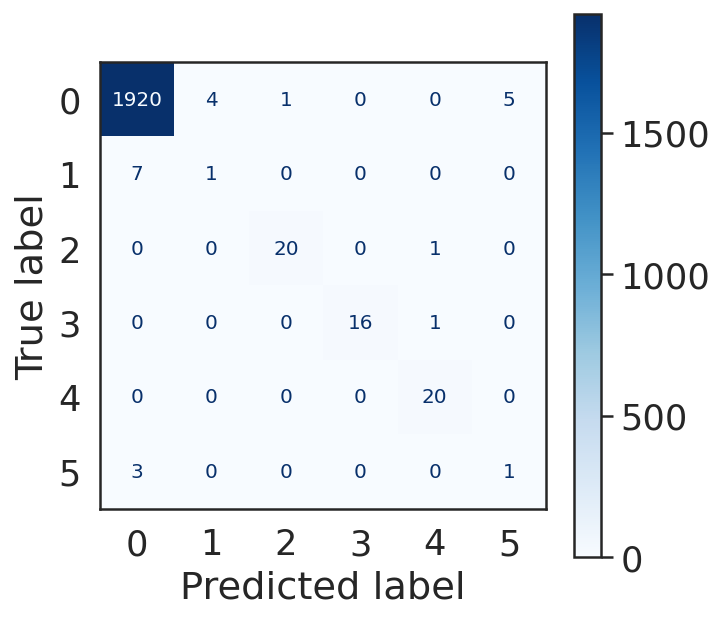

In [49]:
plt.rcParams['figure.figsize']=5,5 
sns.set_style("white")
plot_confusion_matrix(model, X_test, y_test, cmap=plt.cm.Blues)  
plt.show()

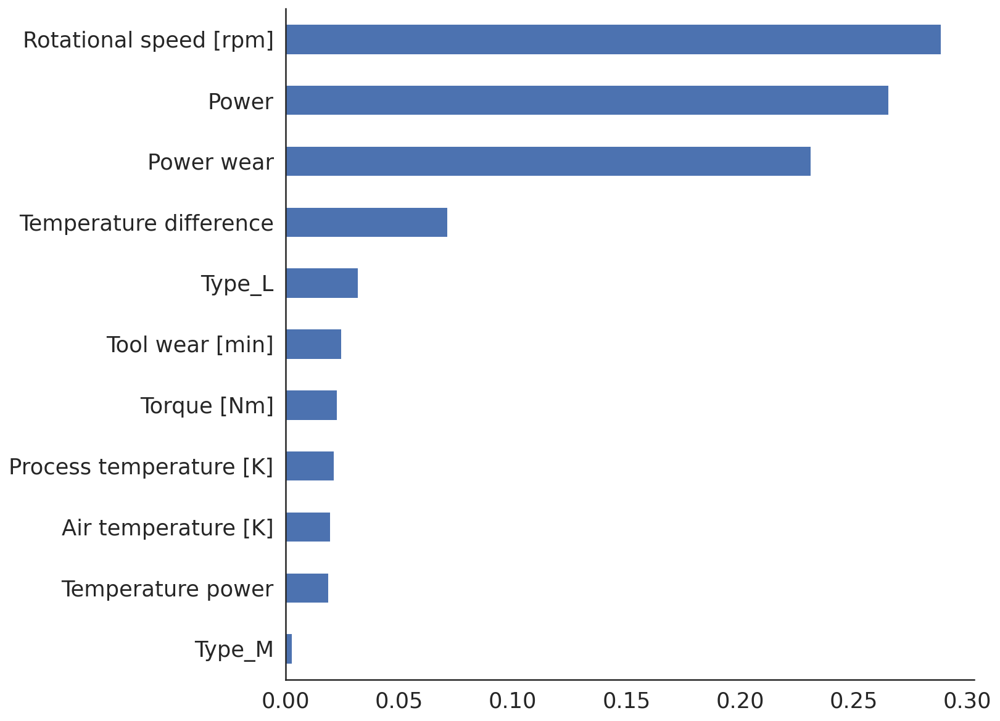

In [50]:
plt.rcParams['figure.figsize']=10,10
sns.set_style("white")
feat_importances = pd.Series(model.feature_importances_, index=feature_names)
feat_importances = feat_importances.groupby(level=0).mean()
feat_importances.nlargest(20).plot(kind='barh').invert_yaxis()
sns.despine()
plt.show()

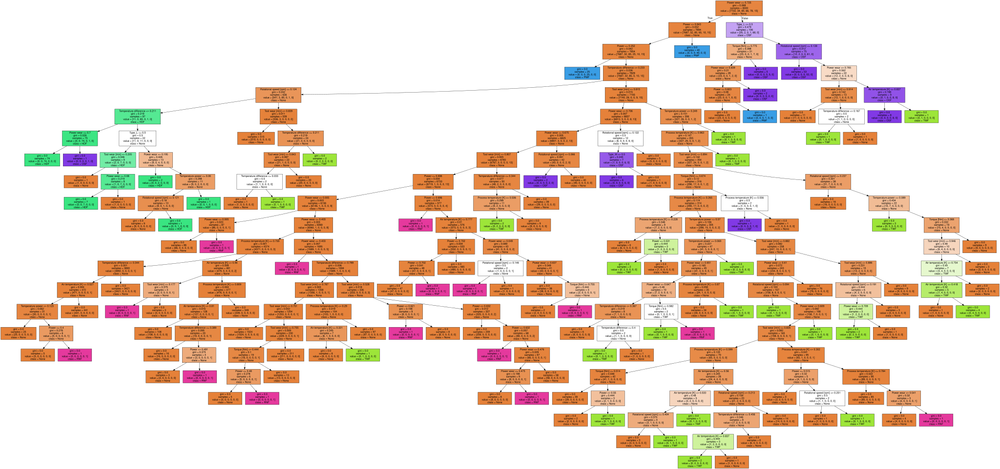

In [51]:
import graphviz
from sklearn import tree
# DOT data
dot_data = tree.export_graphviz(model, out_file=None, 
                                feature_names=X.columns,  
                                class_names=['None','TWF','HDF','PWF','OSF','RNF'],
                                filled=True,
#                                 size="5,5!"
                               )


# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph

<a id='4_5'></a>
## <p style="padding: 8px;color:white; display:fill;background-color:#aaaaaa; border-radius:5px; font-size:100%"> <b>Random Forest</b>

In [52]:
%%time
from sklearn.ensemble import RandomForestClassifier
start = time.time()
model = RandomForestClassifier(n_estimators = 100,n_jobs=-1,random_state=0,bootstrap=True,).fit(X_train,y_train)
end_train = time.time()
y_predictions = model.predict(X_test) # These are the predictions from the test data.
end_predict = time.time()

CPU times: user 2.48 s, sys: 78.8 ms, total: 2.56 s
Wall time: 1.06 s


In [53]:
accuracy = accuracy_score(y_test, y_predictions)
recall = recall_score(y_test, y_predictions, average='weighted')
precision = precision_score(y_test, y_predictions, average='weighted')
f1s = f1_score(y_test, y_predictions, average='weighted')
MCC = matthews_corrcoef(y_test, y_predictions)
# ROC_AUC = roc_auc_score(y_test, y_predictions, average='weighted')
# ROC_AUC = roc_auc_score(y_test, model.predict_proba(X_test)[:,1], average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
print("MCC: "+ "{:.2%}".format(MCC))
# print("ROC AUC score: "+ "{:.2%}".format(ROC_AUC))
print("time to train: "+ "{:.2f}".format(end_train-start)+" s")
print("time to predict: "+"{:.2f}".format(end_predict-end_train)+" s")
print("total: "+"{:.2f}".format(end_predict-start)+" s")
model_performance.loc['Random Forest'] = [accuracy, recall, precision, f1s,MCC,end_train-start,end_predict-end_train,end_predict-start]

Accuracy: 99.35%
Recall: 99.35%
Precision: 98.76%
F1-Score: 99.05%
MCC: 90.08%
time to train: 0.96 s
time to predict: 0.10 s
total: 1.06 s


The figure below shows the confusion matrix for the predictions, the numbers predicted are as follows:
0. No failure
1. tool wear failure (TWF)
2. heat dissipation failure (HDF)
3. power failure (PWF)
4. overstrain failure (OSF)
5. random failures (RNF)

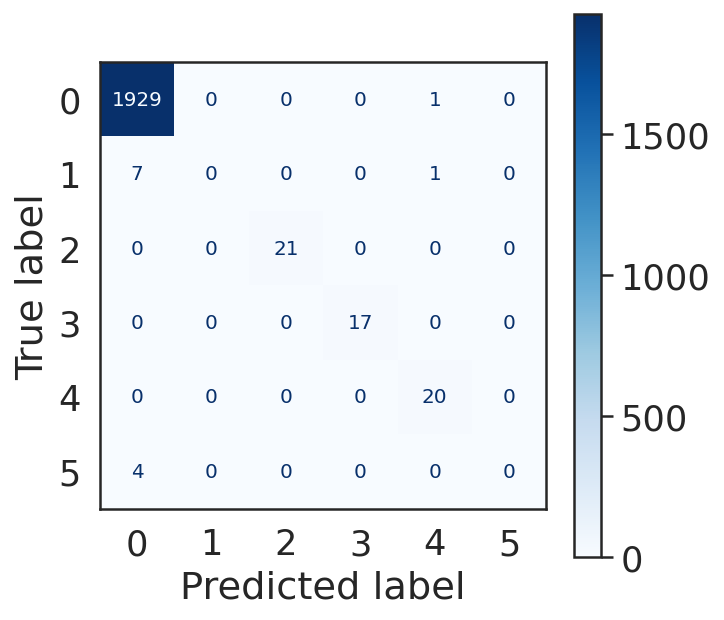

In [54]:
plt.rcParams['figure.figsize']=5,5 
sns.set_style("white")
plot_confusion_matrix(model, X_test, y_test, cmap=plt.cm.Blues)  
plt.show()

<a id='4_6'></a>
## <p style="padding: 8px;color:white; display:fill;background-color:#aaaaaa; border-radius:5px; font-size:100%"> <b>Gradient Boosting Classifier</b>

In [55]:
%%time
from sklearn.ensemble import GradientBoostingClassifier
start = time.time()
model = GradientBoostingClassifier().fit(X_train,y_train)
end_train = time.time()
y_predictions = model.predict(X_test) # These are the predictions from the test data.
end_predict = time.time()

CPU times: user 13 s, sys: 3.68 ms, total: 13 s
Wall time: 13.3 s


In [56]:
accuracy = accuracy_score(y_test, y_predictions)
recall = recall_score(y_test, y_predictions, average='weighted')
precision = precision_score(y_test, y_predictions, average='weighted')
f1s = f1_score(y_test, y_predictions, average='weighted')
MCC = matthews_corrcoef(y_test, y_predictions)
# ROC_AUC = roc_auc_score(y_test, y_predictions, average='weighted')
# ROC_AUC = roc_auc_score(y_test, model.predict_proba(X_test)[:,1], average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
print("MCC: "+ "{:.2%}".format(MCC))
# print("ROC AUC score: "+ "{:.2%}".format(ROC_AUC))
print("time to train: "+ "{:.2f}".format(end_train-start)+" s")
print("time to predict: "+"{:.2f}".format(end_predict-end_train)+" s")
print("total: "+"{:.2f}".format(end_predict-start)+" s")
model_performance.loc['Gradient Boosting'] = [accuracy, recall, precision, f1s,MCC,end_train-start,end_predict-end_train,end_predict-start]

Accuracy: 99.15%
Recall: 99.15%
Precision: 98.80%
F1-Score: 98.98%
MCC: 87.08%
time to train: 13.28 s
time to predict: 0.01 s
total: 13.29 s


The figure below shows the confusion matrix for the predictions, the numbers predicted are as follows:
0. No failure
1. tool wear failure (TWF)
2. heat dissipation failure (HDF)
3. power failure (PWF)
4. overstrain failure (OSF)
5. random failures (RNF)

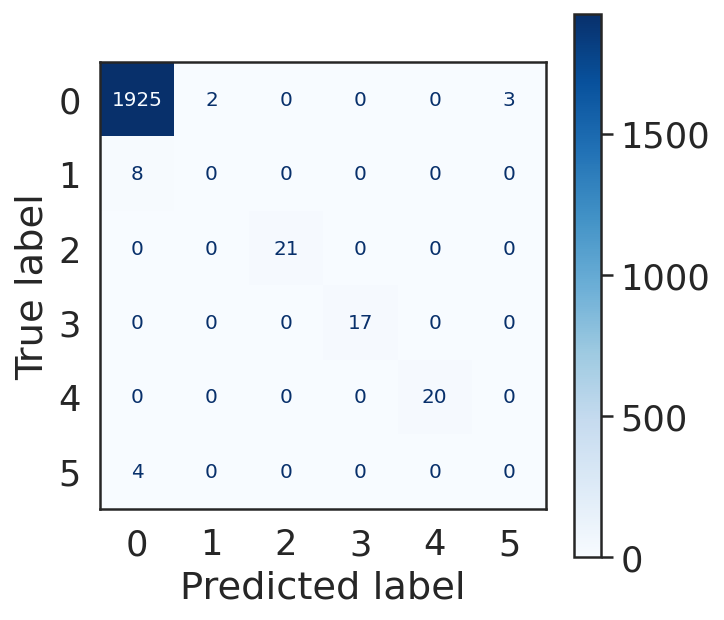

In [57]:
plt.rcParams['figure.figsize']=5,5 
sns.set_style("white")
plot_confusion_matrix(model, X_test, y_test, cmap=plt.cm.Blues)  
plt.show()

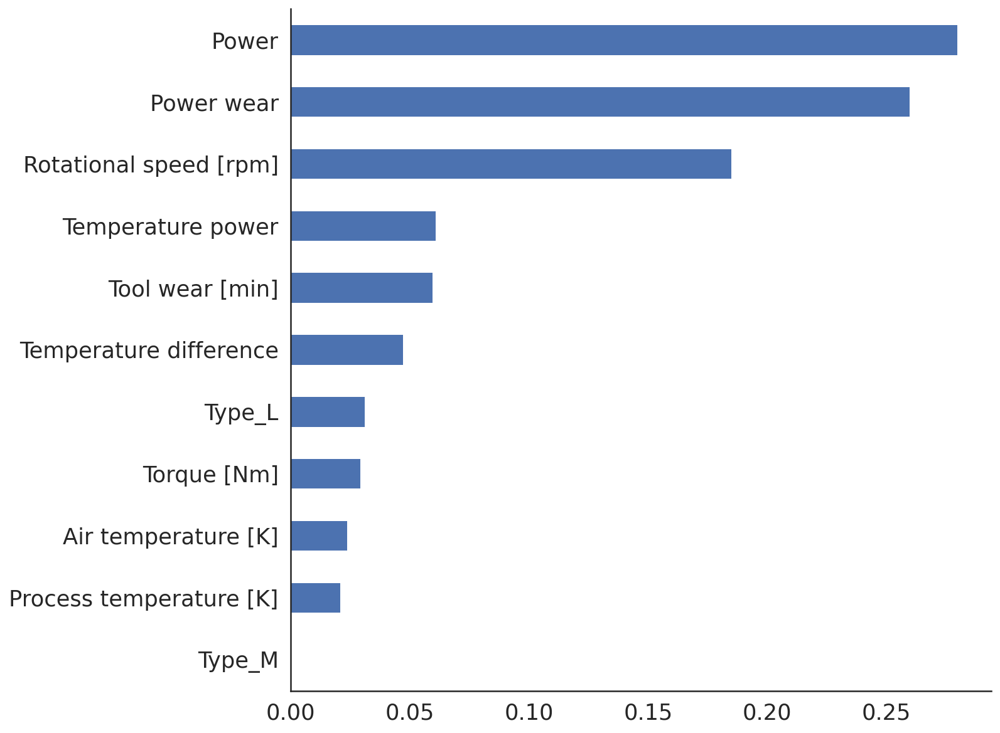

In [58]:
plt.rcParams['figure.figsize']=10,10
sns.set_style("white")
feat_importances = pd.Series(model.feature_importances_, index=feature_names)
feat_importances = feat_importances.groupby(level=0).mean()
feat_importances.nlargest(20).plot(kind='barh').invert_yaxis()
sns.despine()
plt.show()

<a id='4_7'></a>
## <p style="padding: 8px;color:white; display:fill;background-color:#aaaaaa; border-radius:5px; font-size:100%"> <b>Neural Network MLP</b>

In [59]:
%%time
from sklearn.neural_network import MLPClassifier
start = time.time()
model = MLPClassifier(hidden_layer_sizes = (25,25,25), 
                      activation='relu', 
                      solver='adam',
                      batch_size=2000,
                      verbose=0).fit(X_train,y_train)
end_train = time.time()
y_predictions = model.predict(X_test) # These are the predictions from the test data.
end_predict = time.time()

CPU times: user 21.5 s, sys: 12.2 s, total: 33.7 s
Wall time: 8.63 s


In [60]:
accuracy = accuracy_score(y_test, y_predictions)
recall = recall_score(y_test, y_predictions, average='weighted')
precision = precision_score(y_test, y_predictions, average='weighted')
f1s = f1_score(y_test, y_predictions, average='weighted')
MCC = matthews_corrcoef(y_test, y_predictions)
# ROC_AUC = roc_auc_score(y_test, y_predictions, average='weighted')
# ROC_AUC = roc_auc_score(y_test, model.predict_proba(X_test)[:,1], average='weighted')

print("Accuracy: "+ "{:.2%}".format(accuracy))
print("Recall: "+ "{:.2%}".format(recall))
print("Precision: "+ "{:.2%}".format(precision))
print("F1-Score: "+ "{:.2%}".format(f1s))
print("MCC: "+ "{:.2%}".format(MCC))
# print("ROC AUC score: "+ "{:.2%}".format(ROC_AUC))
print("time to train: "+ "{:.2f}".format(end_train-start)+" s")
print("time to predict: "+"{:.2f}".format(end_predict-end_train)+" s")
print("total: "+"{:.2f}".format(end_predict-start)+" s")
model_performance.loc['Neural Network MLP'] = [accuracy, recall, precision, f1s,MCC,end_train-start,end_predict-end_train,end_predict-start]

Accuracy: 97.40%
Recall: 97.40%
Precision: 96.40%
F1-Score: 96.64%
MCC: 51.35%
time to train: 8.62 s
time to predict: 0.00 s
total: 8.62 s


The figure below shows the confusion matrix for the predictions, the numbers predicted are as follows:
0. No failure
1. tool wear failure (TWF)
2. heat dissipation failure (HDF)
3. power failure (PWF)
4. overstrain failure (OSF)
5. random failures (RNF)

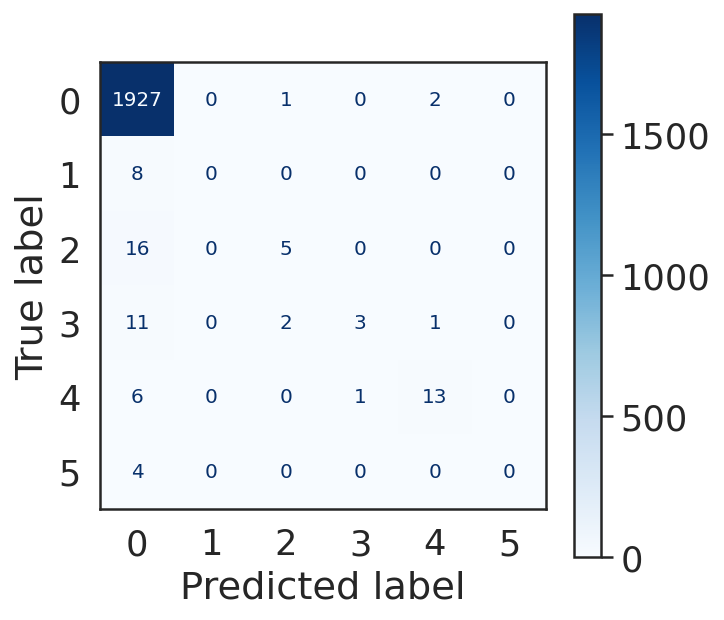

In [61]:
plt.rcParams['figure.figsize']=5,5 
sns.set_style("white")
plot_confusion_matrix(model, X_test, y_test, cmap=plt.cm.Blues)  
plt.show()

<a id='5'></a>
# <p style="padding: 8px;color:white; display:fill;background-color:#555555; border-radius:5px; font-size:100%"> <b>Evaluate</b>

In [62]:
model_performance.fillna(.90,inplace=True)
model_performance.style.background_gradient(cmap='coolwarm').format({'Accuracy': '{:.2%}',
                                                                     'Precision': '{:.2%}',
                                                                     'Recall': '{:.2%}',
                                                                     'F1-Score': '{:.2%}',
                                                                     'MCC score': '{:.2%}',
                                                                     'time to train':'{:.1f}',
                                                                     'time to predict':'{:.1f}',
                                                                     'total time':'{:.1f}',
                                                                     })

,Accuracy,Recall,Precision,F1-Score,MCC score,time to train,time to predict,total time
Logistic,97.30%,97.30%,96.27%,96.56%,49.77%,0.0,0.1,0.1
Decision Tree,98.90%,98.90%,98.87%,98.88%,83.94%,0.1,0.0,0.1
Random Forest,99.35%,99.35%,98.76%,99.05%,90.08%,1.0,0.1,1.1
Gradient Boosting,99.15%,99.15%,98.80%,98.98%,87.08%,13.3,0.0,13.3
Neural Network MLP,97.40%,97.40%,96.40%,96.64%,51.35%,8.6,0.0,8.6


<a id='6'></a>
# <p style="padding: 8px;color:white; display:fill;background-color:#555555; border-radius:5px; font-size:100%"> <b>Conclusion</b>

The bulk of the prediction lays with the type Product L that strongly suggests a failure. This however only gave a 90% accuracy. I dropped the type and got much more accurate results as a result. Random forest and Gradient Boosting classfieir seems to be the go-to models for this case, giving even a decent MCC score.

Thus the multiclass evaluation shows that the failure modes can also be found with accuracy.

don't forget to upvote if you found this useful.